In [ ]:
%%bash
set -e

# === Configuration ===

# Default values
DEFAULT_DIR="./downloads"

# Parse arguments
TARGET_DIR="${1:-$DEFAULT_DIR}"

# Create the directory if it doesn't exist
mkdir -p "${TARGET_DIR}"

# URL and filename
URL="https://MYTOKEN.cloudfront.net/public/v1.0/v1.0-trainval01_blobs_lidar.tgz"
FILE="v1.0-trainval01_blobs_lidar.tgz"
DEST="${TARGET_DIR}/${FILE}"

echo "Downloading ${FILE} into ${TARGET_DIR}..."

# Download
echo "Downloading ${FILE}..."
wget -c "${URL}" -O "${DEST}"
echo "Saved to ${DEST}"

echo "✅ Download completed successfully to ${TARGET_DIR}."

Saved to ./downloads/v1.0-trainval01_blobs_lidar.tgz
✅ Download completed successfully to ./downloads.


--2025-08-22 19:53:50--  https://d36yt3mvayqw5m.cloudfront.net/public/v1.0/v1.0-trainval01_blobs_lidar.tgz
Resolving d36yt3mvayqw5m.cloudfront.net (d36yt3mvayqw5m.cloudfront.net)... 18.154.207.108, 18.154.207.79, 18.154.207.208, ...
Connecting to d36yt3mvayqw5m.cloudfront.net (d36yt3mvayqw5m.cloudfront.net)|18.154.207.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13753425271 (13G) [application/x-tar]
Saving to: ‘./downloads/v1.0-trainval01_blobs_lidar.tgz’

     0K .......... .......... .......... .......... ..........  0%  448K 8h19m
    50K .......... .......... .......... .......... ..........  0%  487K 7h59m
   100K .......... .......... .......... .......... ..........  0%  479K 7h55m
   150K .......... .......... .......... .......... ..........  0% 18.5M 5h59m
   200K .......... .......... .......... .......... ..........  0% 25.0M 4h49m
   250K .......... .......... .......... .......... ..........  0%  493K 5h16m
   300K .......... .......... ..

In [ ]:
!tar -xf /content/downloads/v1.0-trainval01_blobs_lidar.tgz -C /content/downloads

In [ ]:
!pip install Shapely

In [ ]:
!pip install pyquaternion

  Using cached pyquaternion-0.9.9-py3-none-any.whl.metadata (1.4 kB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
nuscenes-devkit 1.1.11 requires descartes, which is not installed.
nuscenes-devkit 1.1.11 requires fire, which is not installed.
nuscenes-devkit 1.1.11 requires matplotlib<3.6.0, but you have matplotlib 3.10.0 which is incompatible.
nuscenes-devkit 1.1.11 requires Shapely<2.0.0, but you have shapely 2.1.1 which is incompatible.


In [ ]:
!pip install nuscenes-devkit --no-deps

  Using cached nuscenes_devkit-1.1.11-py3-none-any.whl.metadata (15 kB)


In [ ]:
%matplotlib inline
from nuscenes.nuscenes import NuScenes
import numpy as np
lidar_path = "/content/downloads/samples/LIDAR_TOP/n008-2018-08-01-15-16-36-0400__LIDAR_TOP__1533151061547455.pcd.bin"
points = np.fromfile(lidar_path, dtype=np.float32).reshape(-1, 5)

# unpack
import numpy as np
import cv2

def render_bev_from_pcd_bin(pcd_bin_path, side=512, scale=5, offset=50):
    # Load lidar point cloud: (N, 5) -> x,y,z,intensity,ring
    points = np.fromfile(pcd_bin_path, dtype=np.float32).reshape(-1, 5)

    # Use XY only
    xs, ys = points[:, 0], points[:, 1]

    # Create empty BEV canvas
    bev_img = np.zeros((side, side), dtype=np.uint8)

    # Project to image coords
    for x, y in zip(xs, ys):
        x_img = int((x + offset) * scale)
        y_img = int((y + offset) * scale)
        if 0 <= x_img < side and 0 <= y_img < side:
            bev_img[side - 1 - y_img, x_img] = 255  # flip y

    return bev_img

# Example usage:
# bev = render_bev_from_pcd_bin("samples/LIDAR_TOP/...pcd.bin")
# cv2.imshow("BEV", bev); cv2.waitKey(0)

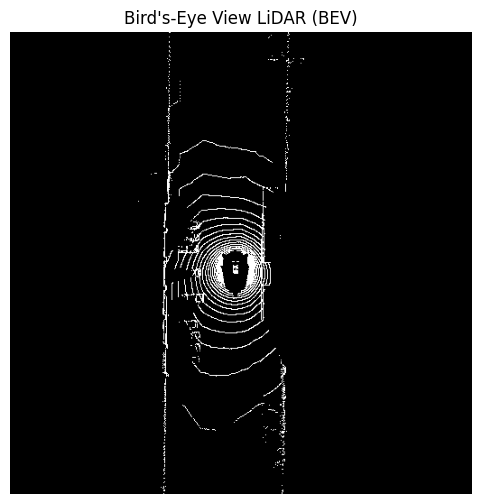

In [ ]:
from matplotlib import pyplot as plt

bev_img = render_bev_from_pcd_bin(lidar_path)

plt.figure(figsize=(6, 6))
plt.imshow(bev_img, cmap='gray')
plt.title("Bird's-Eye View LiDAR (BEV)")
plt.axis('off')
plt.show()